In [13]:
import sys
import numpy
import matplotlib.pyplot as plt, pandas as pd, matplotlib as mpl, random
def utkarshGrid(): plt.minorticks_on() ; plt.grid(color='grey',which='minor',linestyle=":",linewidth='0.1',) ; plt.grid(color='black',which='major',linestyle=":",linewidth='0.1',); return None
def utkarshGridAX(ax): ax.minorticks_on() ; ax.grid(color='grey',which='minor',linestyle=":",linewidth='0.1',) ; ax.grid(color='black',which='major',linestyle=":",linewidth='0.1',); return None
mpl.rcParams['legend.frameon'], mpl.rcParams['figure.autolayout'] = False, True,
colour = ["dodgerblue", "goldenrod", "crimson", "teal", "yellowgreen", "grey"]
plt.rcParams.update({"text.usetex": True, "font.family": "serif", "font.serif": ["Palatino"],})
def utkarshWrapper(): plt.legend();plt.utkarshGrid() ;plt.gca().tick_params(direction='in', which='both', right=True, top=True); plt.tight_layout(); return None
def utkarshWrapperAX(ax): utkarshGridAX(ax); ax.tick_params(direction='in', which='both', right=True, top=True); return None; 
plt.utkarshGrid = utkarshGrid; plt.utkarshWrapper = utkarshWrapper
def colour_sample(n = 2, col = colour, seed = 7236): random.seed(seed) ; return random.sample(colour, n)
plt.rcParams["image.cmap"] = "Set2" # I recommend, Set2, Dark2
plt.rcParams['axes.prop_cycle'] = plt.cycler(color=colour) # Use your own OR plt.cm.Set2.colors

In [14]:
%reload_ext autoreload
%autoreload 2
from run_inference import *
from postprocessing_functions import *

In [15]:
mcmc = None
path = f"results/prior"
mcmc = pickle_read(path)
prior_samples = infer_samples(mcmc)

In [16]:
mcmc = None
path = f"results/posterior"
mcmc = pickle_read(path)
posterior_samples = infer_samples(mcmc)
mcmc.print_summary()


                         mean       std    median      5.0%     95.0%     n_eff     r_hat
               A[0]      0.03      0.58      0.05     -0.84      0.95   8793.64      1.00
         alpha_1[0]     -1.43      1.58     -1.25     -4.41      0.68   4459.43      1.00
         alpha_2[0]     -0.17      0.46     -0.17     -0.91      0.57   3980.74      1.00
          beta_1[0]      1.13      0.49      1.08      0.34      1.93   8081.43      1.00
          beta_2[0]      2.34      0.80      2.26      1.02      3.58   2862.40      1.00
        eta_high[0]     25.10     14.37     25.03      3.05     47.60  13617.49      1.00
         eta_low[0]     24.90     14.49     24.95      0.94     45.87  13281.38      1.00
         eta_max[0]      4.53      2.68      4.36      0.01      8.43  10522.38      1.00
         eta_min[0]     30.59     11.42     30.98     13.83     49.32  14523.80      1.00
      gamma_high[0]      6.02      1.17      6.02      4.41      8.00  10487.74      1.00
       ga

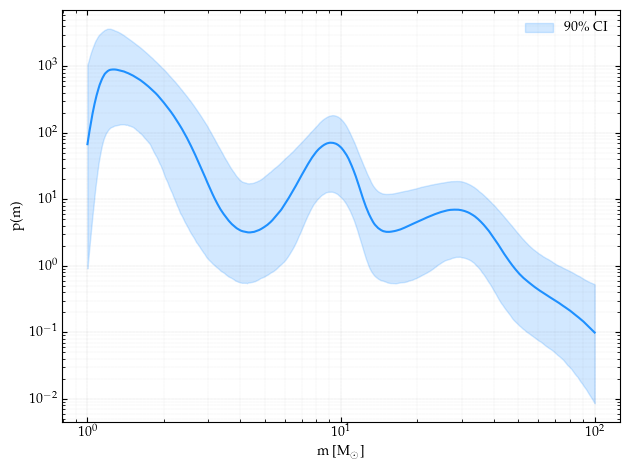

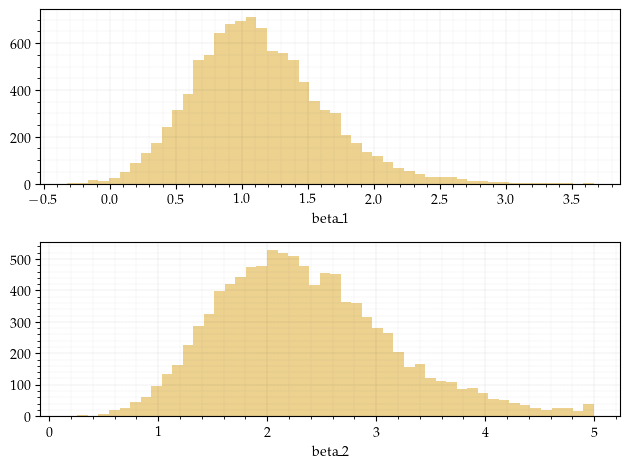

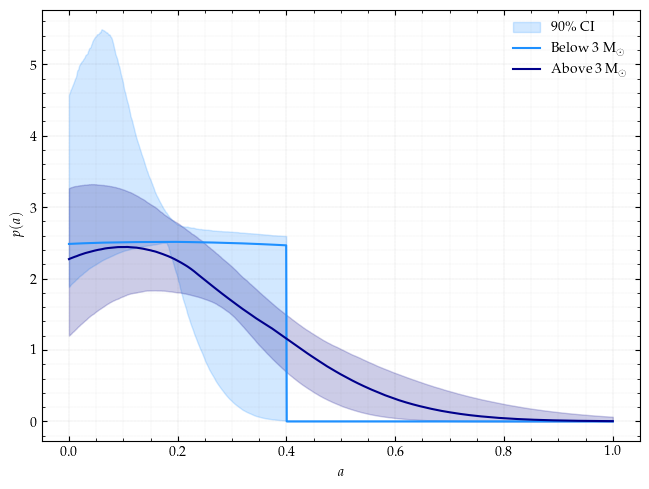

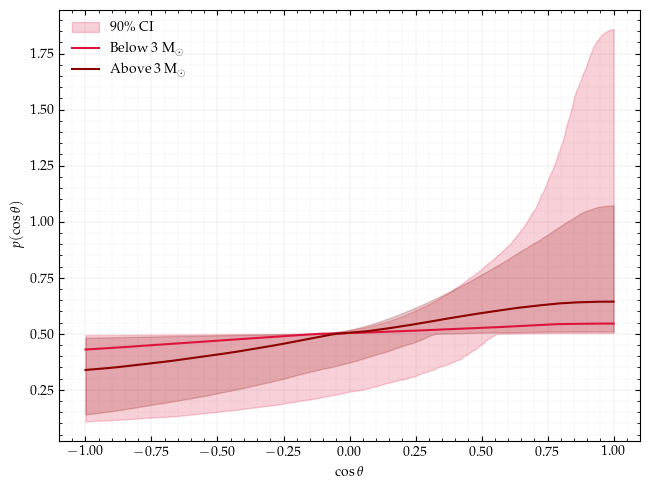

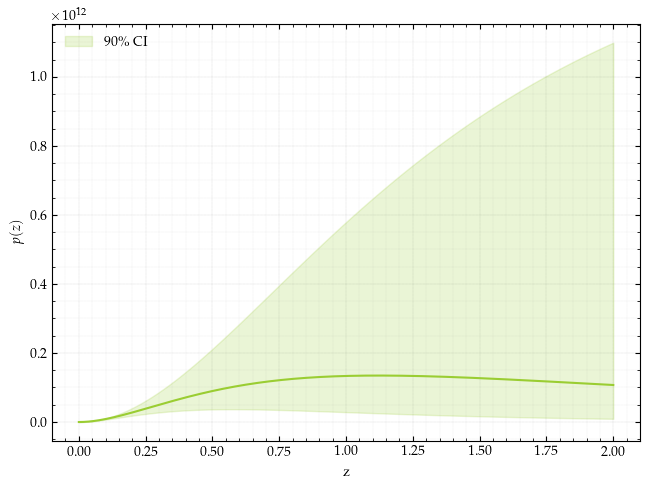

In [17]:
from config.mass1d_func import pdb_with_NG
from config.spin_func import prob_chi, prob_costilt
from config.distance_func import powerlaw_distance

plot_p_m(posterior_samples, function=pdb_with_NG)
plot_p_pairing(posterior_samples)
plot_p_chi(posterior_samples, function=prob_chi)
plot_p_costilt(posterior_samples, function=prob_costilt)
plot_p_z(posterior_samples, function=powerlaw_distance)
plt.show()

In [18]:
# import arviz as az
# data = az.from_numpyro(mcmc)
# var_names_lst = get_non_deterministic_params(mcmc)
#
# if len(var_names_lst) >= 20:
#     cut1 = var_names_lst[:20]
#     cut2 = var_names_lst[20:]
#
#     assert len(cut1) + len(cut2) == len(var_names_lst)
#
#     az.plot_trace(data, var_names=cut1, compact=True)
#     plt.savefig("results/trace1.png")
#     az.plot_trace(data, var_names=cut2, compact=True)
#     plt.savefig("results/trace2.png")
# else:
#     az.plot_trace(data, var_names=var_names_lst, compact=True)
#     plt.savefig("results/trace.png")

In [138]:
path = f"results/posterior"
mcmc = pickle_read(path)
posterior_samples = infer_samples(mcmc)
mdep_posterior_samples = posterior_samples

condition_chi = np.abs(mdep_posterior_samples["mu_chi1"] - mdep_posterior_samples["mu_chi2"])
tol_chi = 0.2
cut_idx_chi = condition_chi < tol_chi

condition_sig_chi = np.abs(mdep_posterior_samples["sig_chi1"] - mdep_posterior_samples["sig_chi2"])
tol_sig = 2
cut_idx_sig = condition_sig_chi < tol_sig

condition_tilt = np.abs(mdep_posterior_samples["sig_tilt1"] - mdep_posterior_samples["sig_tilt2"])
tol_tilt = 2
cut_idx_tilt = condition_tilt < tol_tilt

condition_mix= np.abs(mdep_posterior_samples["mix_tilt1"] - mdep_posterior_samples["mix_tilt2"])
tol_mix = 0.5
cut_idx_mix = condition_mix < tol_mix

cut_idx = np.logical_and(np.logical_and(np.logical_and(cut_idx_chi, cut_idx_tilt), cut_idx_mix), cut_idx_sig)

print(mdep_posterior_samples.keys())
print(cut_idx.sum())
mdep_cut = {key: value[cut_idx] for key, value in mdep_posterior_samples.items()}
assert cut_idx.sum() == len(mdep_cut["mu_chi1"])
mdep_cut["mu_chi"] = mdep_cut["mu_chi1"]
del mdep_cut["mu_chi1"]
del mdep_cut["mu_chi2"]
mdep_cut["sig_tilt"] =  mdep_cut["sig_tilt1"]
del mdep_cut["sig_tilt1"]
del mdep_cut["sig_tilt2"]
mdep_cut["mix_tilt"] =  mdep_cut["mix_tilt1"]
del mdep_cut["mix_tilt1"]
del mdep_cut["mix_tilt2"]
mdep_cut["sig_chi"] =  mdep_cut["sig_chi1"]
del mdep_cut["sig_chi1"]
del mdep_cut["sig_chi2"]

dict_keys(['A', 'alpha_1', 'alpha_2', 'beta_1', 'beta_2', 'eta_high', 'eta_low', 'eta_max', 'eta_min', 'gamma_high', 'gamma_low', 'kappa', 'm_break', 'm_max', 'm_min', 'mix_tilt1', 'mix_tilt2', 'mu_chi1', 'mu_chi2', 'mu_peak1', 'mu_peak2', 'mu_peak_NS', 'peak_constant1', 'peak_constant2', 'peak_constant_NS', 'sig_chi1', 'sig_chi2', 'sig_peak1', 'sig_peak2', 'sig_peak_NS', 'sig_tilt1', 'sig_tilt2'])
4524


In [139]:
mcmc = None
path = f"../eng14_nocosmoPE_full/results/posterior"
mcmc = pickle_read(path)
mindep_posterior_samples = infer_samples(mcmc)
print(np.median(mindep_posterior_samples["mu_chi"]))
mindep_cut = mindep_posterior_samples
len(mindep_cut["A"])

0.1402442783976964


10000

In [140]:
mdep_cut = dict(sorted(mdep_cut.items()))
mindep_cut = dict(sorted(mindep_cut.items()))

assert set(mdep_cut.keys()) == set(mindep_cut.keys())
# keys_only_in_dict1 = set(mdep_cut.keys()) - set(mindep_cut.keys())
# keys_only_in_dict2 = set(mindep_cut.keys()) - set(mdep_cut.keys())
# print(keys_only_in_dict1, keys_only_in_dict2)

(1, 10000, 28) (4524, 28)


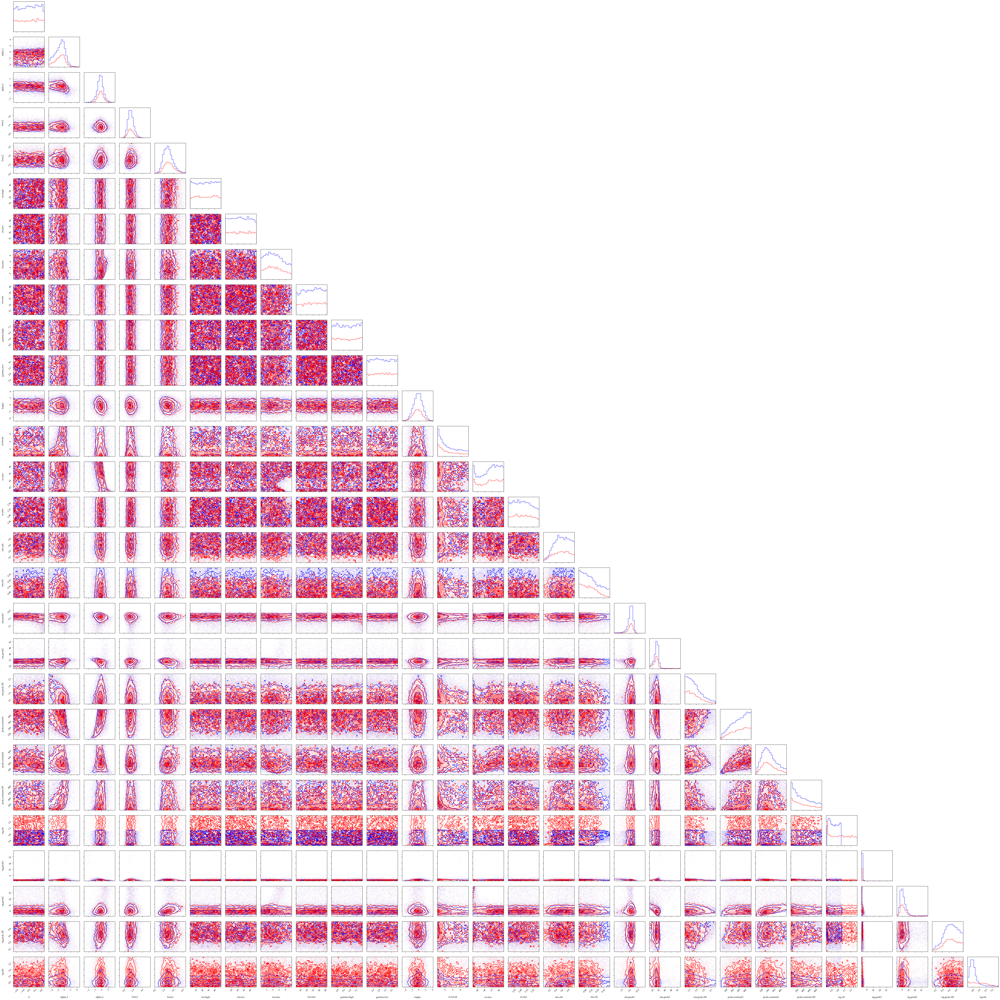

In [141]:
data1 = np.array(list(mindep_cut.values())).T
data2 = np.array(list(mdep_cut.values())).T

print(data1.shape, data2.shape)

f1 = corner.corner(data1, color = "blue")
corner.corner(data2, fig = f1, color = "red", labels=list(mdep_cut.keys()))
plt.savefig("results/compare_corner.png")